In [1]:
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
import pandas as pd
import os
from tqdm import tqdm

# Data loading

In [3]:
# The folder path where images are stored
folder_path = '../Data/all-mias/'

# Get all file with .pgm extension
pgm_files = [folder_path + f for f in os.listdir(folder_path) if f.endswith('.pgm')]

# Load all images
breast_images = []
for i in tqdm(range(len(pgm_files))):
    image = Image.open(pgm_files[i])

    breast_images += [image]

100%|██████████| 322/322 [00:00<00:00, 13032.20it/s]


In [4]:
infos_df = pd.read_csv("../Data/breasts_infos.txt", sep='\s+', names=["image_idx", "tissue", "abnormality", "severity", "x_coord", "y_coord", "radius"])

infos_df = infos_df.fillna(0) # Fill NaN
infos_df["x_coord"] = pd.to_numeric(infos_df["x_coord"], errors="coerce").fillna(0).astype(int) # Convert objetc to int
infos_df["y_coord"] = pd.to_numeric(infos_df["y_coord"], errors="coerce").fillna(0).astype(int)

In [29]:
infos_df

,image_idx,tissue,abnormality,severity,x_coord,y_coord,radius
0,mdb001,G,CIRC,B,535,425,197.0
1,mdb002,G,CIRC,B,522,280,69.0
2,mdb003,D,NORM,0,0,0,0.0
3,mdb004,D,NORM,0,0,0,0.0
4,mdb005,F,CIRC,B,477,133,30.0
...,...,...,...,...,...,...,...
325,mdb318,D,NORM,0,0,0,0.0
326,mdb319,D,NORM,0,0,0,0.0
327,mdb320,D,NORM,0,0,0,0.0
328,mdb321,D,NORM,0,0,0,0.0


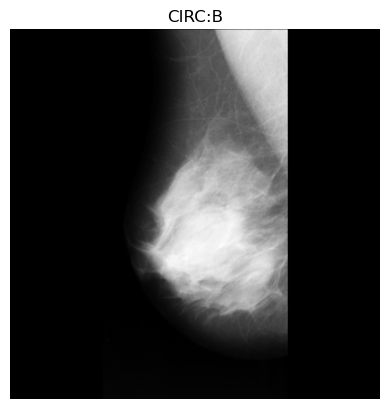

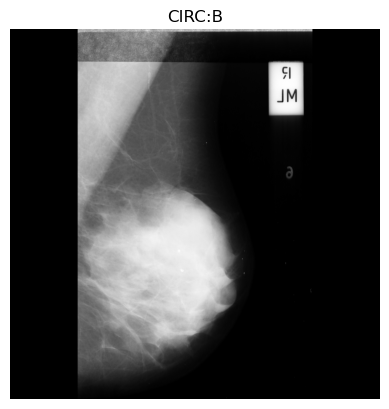

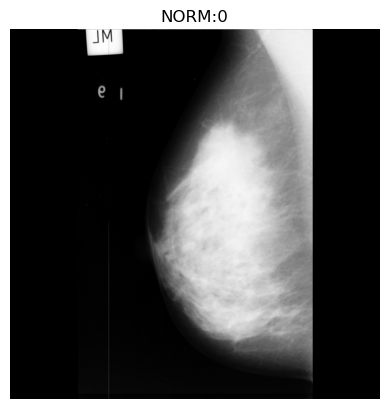

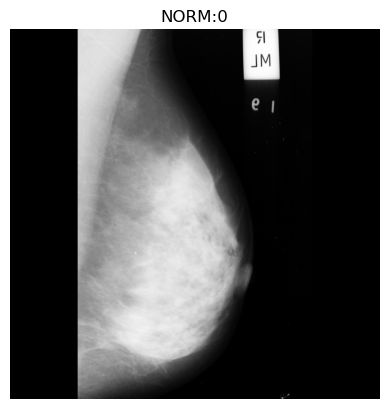

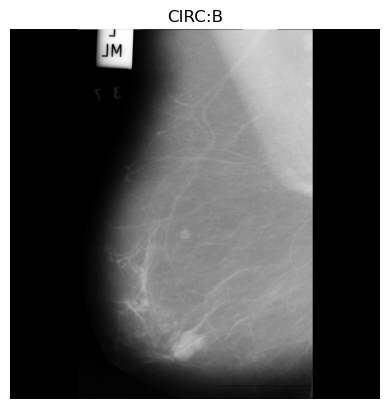

...

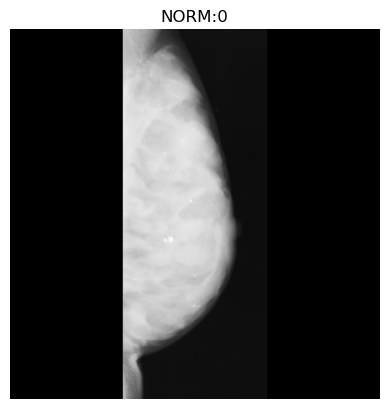

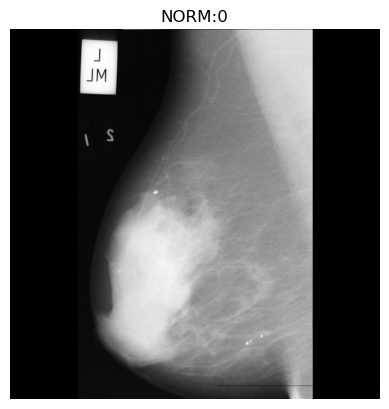

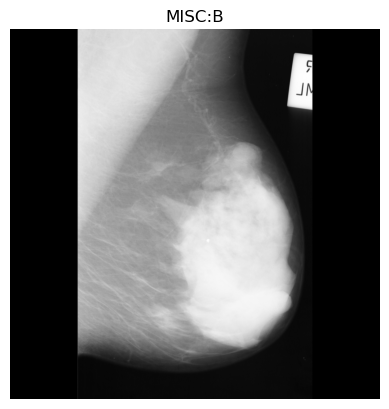

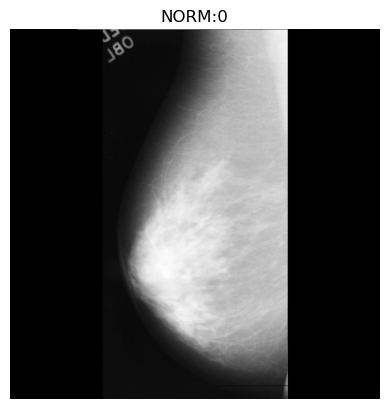

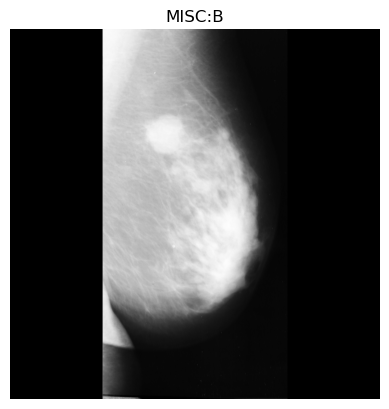

In [5]:
# Plot images
for i in range(len(breast_images)):
    plt.figure()
    plt.imshow(breast_images[i], cmap='gray')  # cmap='gray' for gray scale
    plt.title(infos_df.iloc[i]["abnormality"] + ":" + str(infos_df.iloc[i]["severity"]))
    plt.axis('off')
    plt.show()

In [ ]:
# Plot images avec des cercles rouges
for i in range(len(breast_images)):
    # Crée la figure et affiche l'image
    plt.figure()
    plt.imshow(breast_images[i], cmap='gray')  # cmap='gray' pour les images en niveaux de gris
    plt.title(infos_df.iloc[i]["abnormality"] + ":" + str(infos_df.iloc[i]["severity"]))
    plt.axis('off')
    
    # Récupère les coordonnées et le rayon
    x = infos_df.iloc[i]["x_coord"]
    y = infos_df.iloc[i]["y_coord"]
    radius = infos_df.iloc[i]["radius"]
    
    # Récupère la hauteur de l'image
    _, height = breast_images[i].size  # width, height
    
    # Ajuste Y pour inverser les coordonnées (de bas en haut)
    y_inverted = height - y
    
    # Ajoute un cercle rouge
    circle = Circle((x, y_inverted), radius, color='red', fill=False, linewidth=2)
    plt.gca().add_patch(circle)
    
    # Affiche l'image avec le cercle
    plt.show()